In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier

from utils import evaluate_and_augment_test, plot_prediction

%load_ext autoreload
%autoreload 2

# Creating spiral dataset

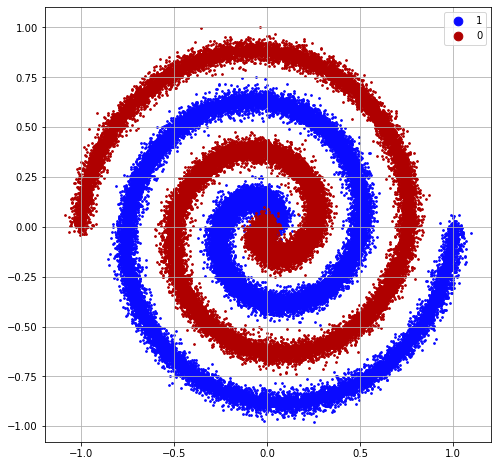

In [2]:
n = 50000
theta = np.random.uniform(0, 4*np.pi, n)
expansion_rate_one = 0.08
expansion_rate_two = -0.08
a, b = 0, 0.04

x1 = expansion_rate_one*theta*np.cos(theta) + np.random.normal(0, np.random.uniform(a, b, n), n)
y1 = expansion_rate_one*theta*np.sin(theta) + np.random.normal(0, np.random.uniform(a, b, n), n)

x2 = expansion_rate_two*theta*np.cos(theta) + np.random.normal(0, np.random.uniform(a, b, n), n)
y2 = expansion_rate_two*theta*np.sin(theta) + np.random.normal(0, np.random.uniform(a, b, n), n)

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
ax.scatter(x1, y1, c="#0A0AFF", s=3, label="1")
ax.scatter(x2, y2, c="#AF0000", s=3, label="0")
ax.grid()
ax.legend(markerscale=5);

In [3]:
df1 = pd.DataFrame({
    "x": x1,
    "y": y1,
    "target": 1
})

df2 = pd.DataFrame({
    "x": x2,
    "y": y2,
    "target": 0
})

df = pd.concat([df1, df2])
df.reset_index(inplace=True, drop=True)
del df1; del df2

# Using $x$, $y$ as inputs

In [4]:
X_train, X_test, y_train, y_test = train_test_split(
    df[["x", "y"]], df["target"],
    test_size=0.25, shuffle=True
)

              precision    recall  f1-score   support

           0       0.52      0.52      0.52     12562
           1       0.51      0.52      0.51     12438

    accuracy                           0.52     25000
   macro avg       0.52      0.52      0.52     25000
weighted avg       0.52      0.52      0.52     25000



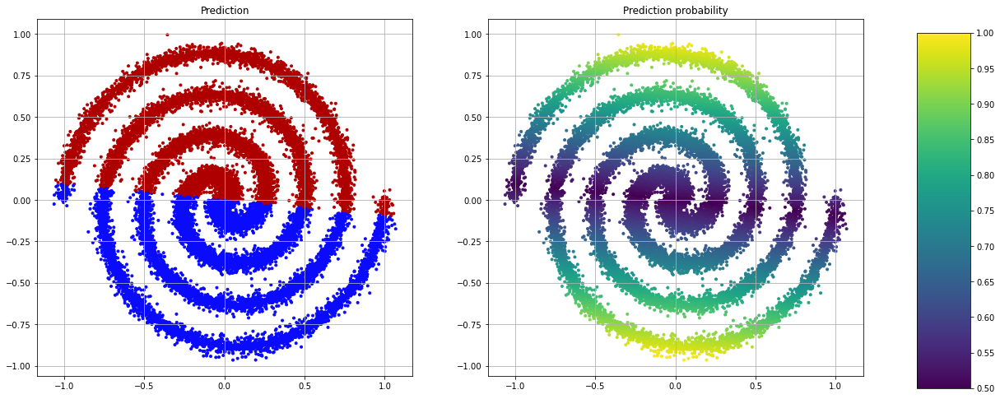

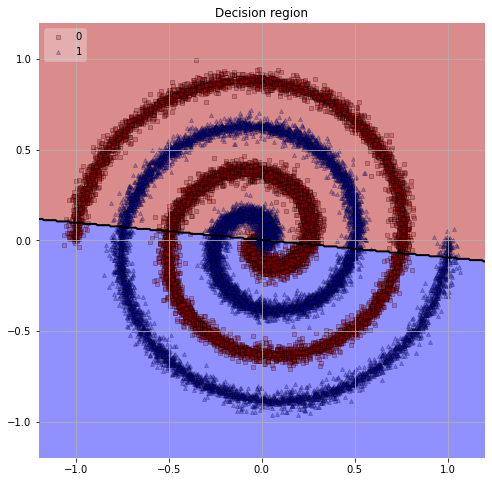

In [5]:
lr_clf = LogisticRegression(random_state=0)
lr_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, lr_clf)
plot_prediction(X_test_augmented, y_test, lr_clf)

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12562
           1       0.99      0.99      0.99     12438

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



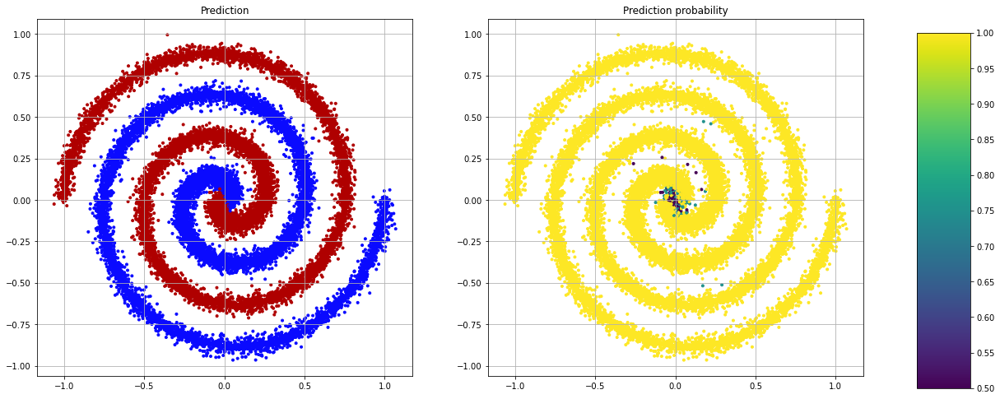

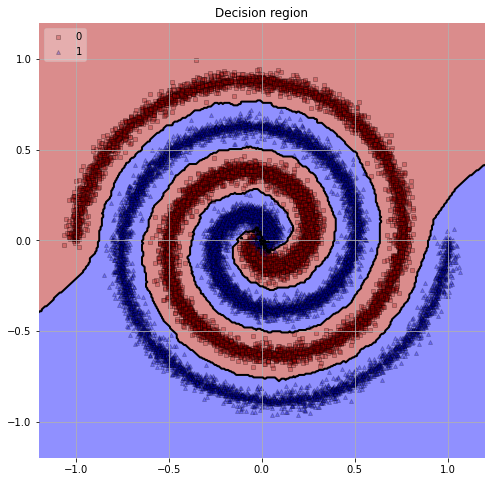

In [6]:
knn_clf = KNeighborsClassifier()
knn_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, knn_clf)
plot_prediction(X_test_augmented, y_test, knn_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.53      0.48      0.50     12562
           1       0.52      0.58      0.55     12438

    accuracy                           0.53     25000
   macro avg       0.53      0.53      0.53     25000
weighted avg       0.53      0.53      0.53     25000



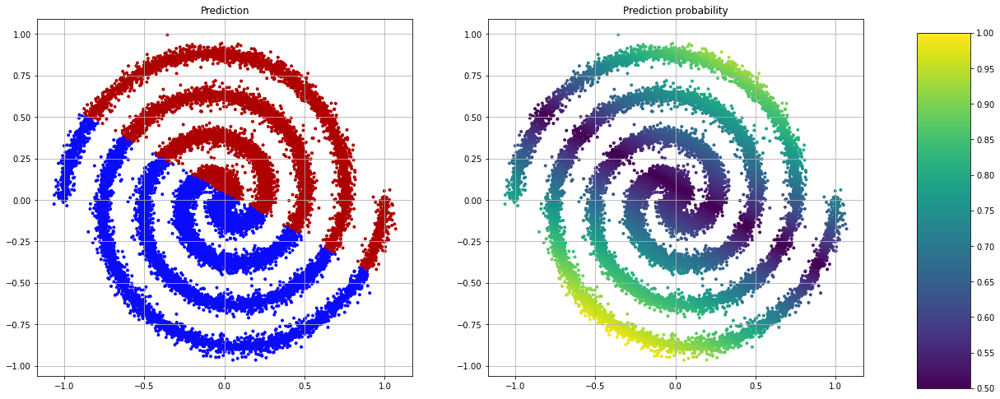

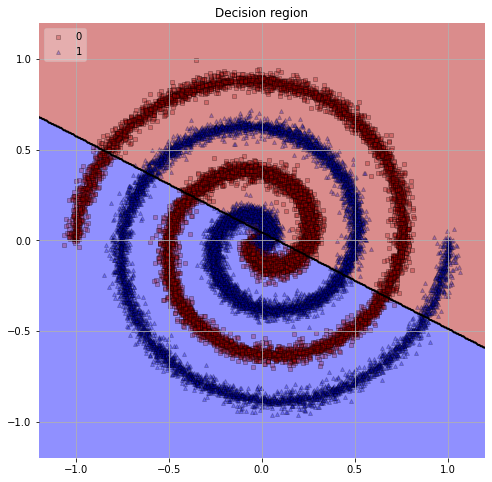

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.45      0.07      0.12     12562
           1       0.49      0.91      0.64     12438

    accuracy                           0.49     25000
   macro avg       0.47      0.49      0.38     25000
weighted avg       0.47      0.49      0.38     25000



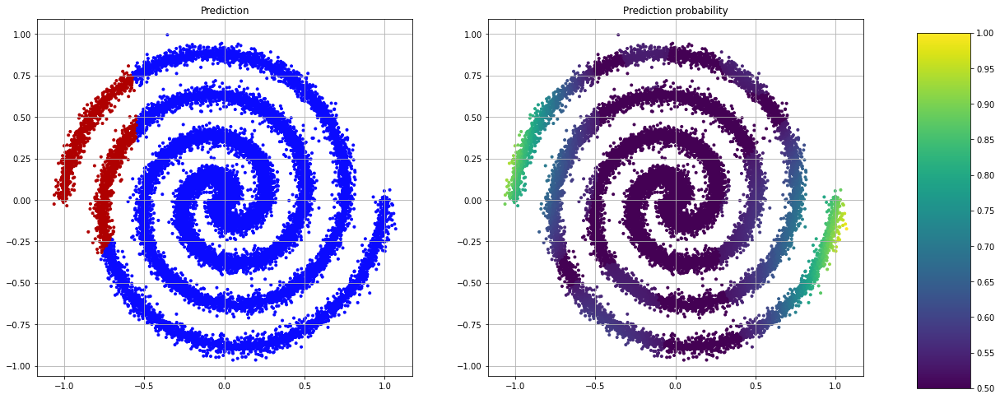

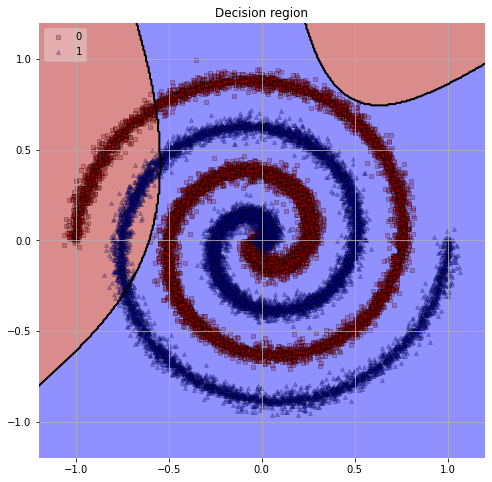

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.44      0.55      0.49     12562
           1       0.38      0.29      0.33     12438

    accuracy                           0.42     25000
   macro avg       0.41      0.42      0.41     25000
weighted avg       0.41      0.42      0.41     25000



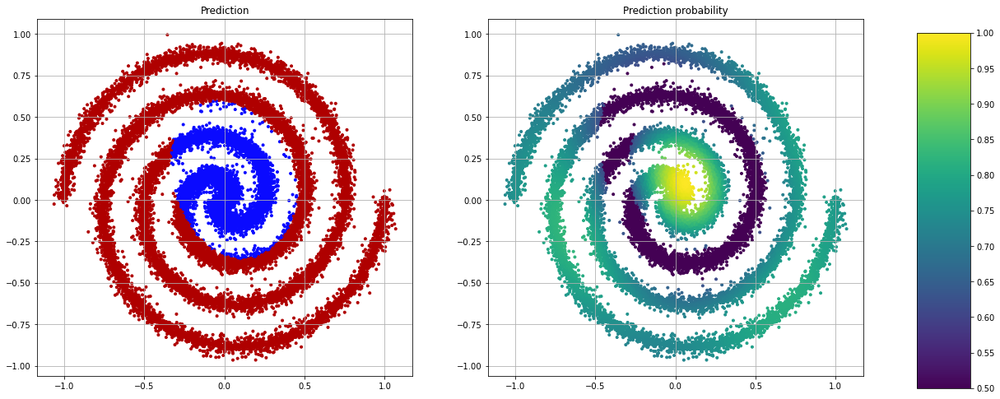

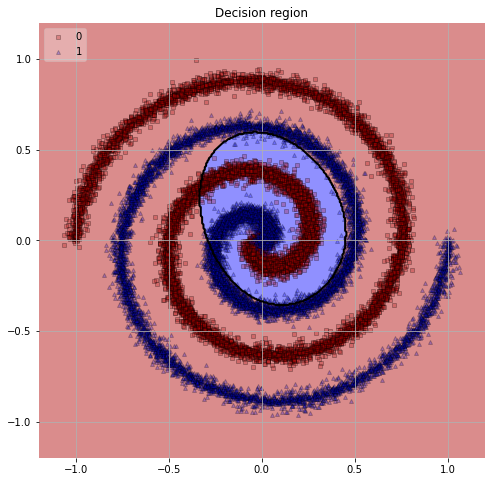

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.53      0.38      0.44     12562
           1       0.51      0.66      0.57     12438

    accuracy                           0.52     25000
   macro avg       0.52      0.52      0.51     25000
weighted avg       0.52      0.52      0.51     25000



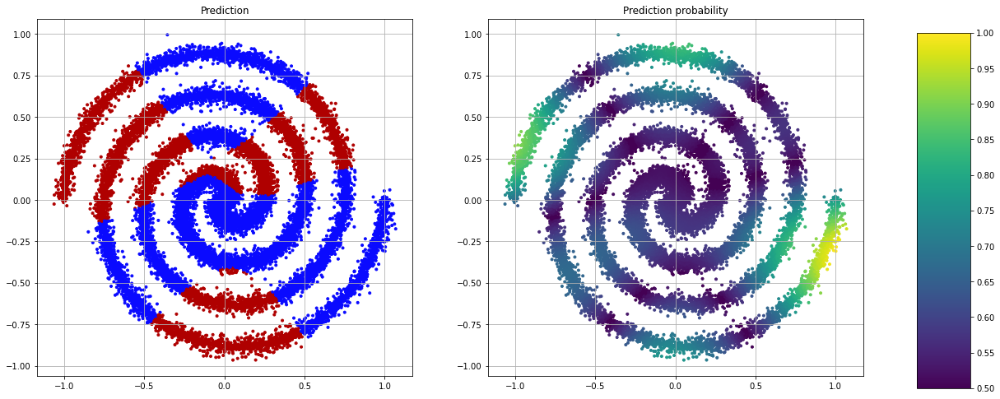

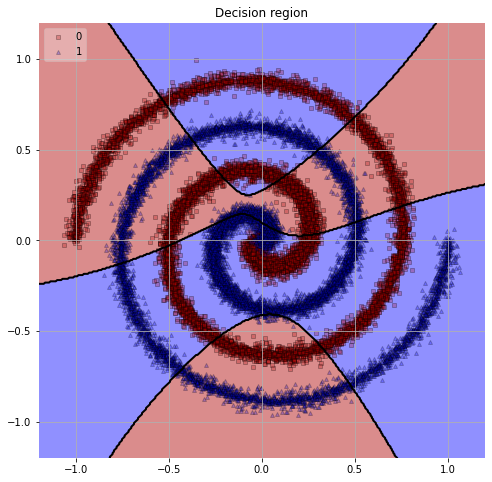

In [7]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    plot_prediction(X_test_augmented, y_test, svc_clf)

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12562
           1       0.99      0.99      0.99     12438

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



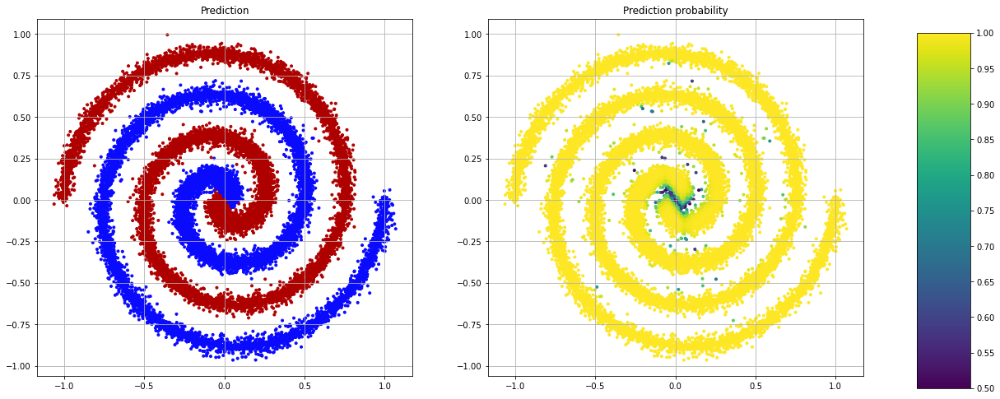

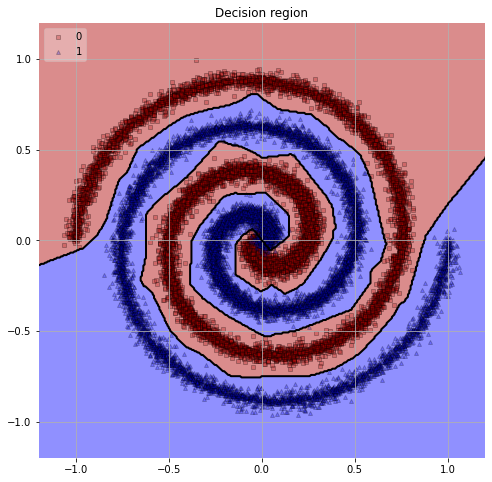

In [8]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300, hidden_layer_sizes=(32, 32))
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12562
           1       0.99      0.99      0.99     12438

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



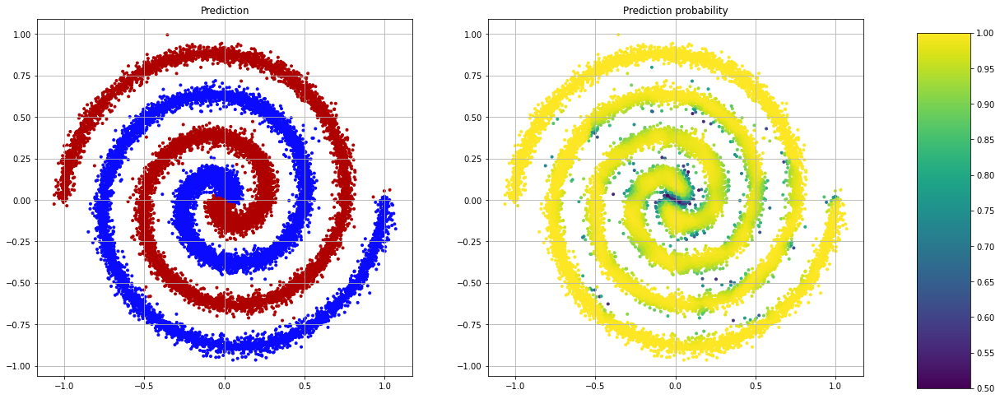

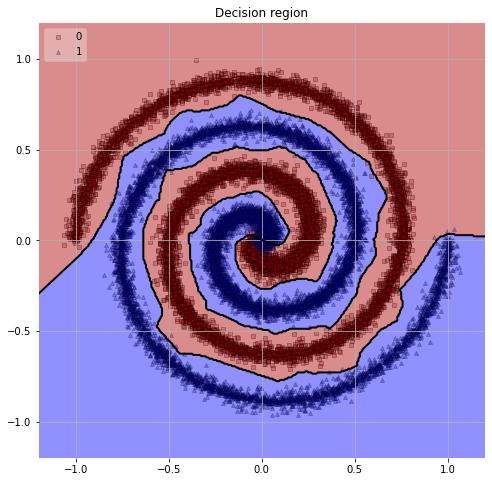

In [9]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.97      0.97      0.97     12562
           1       0.97      0.97      0.97     12438

    accuracy                           0.97     25000
   macro avg       0.97      0.97      0.97     25000
weighted avg       0.97      0.97      0.97     25000



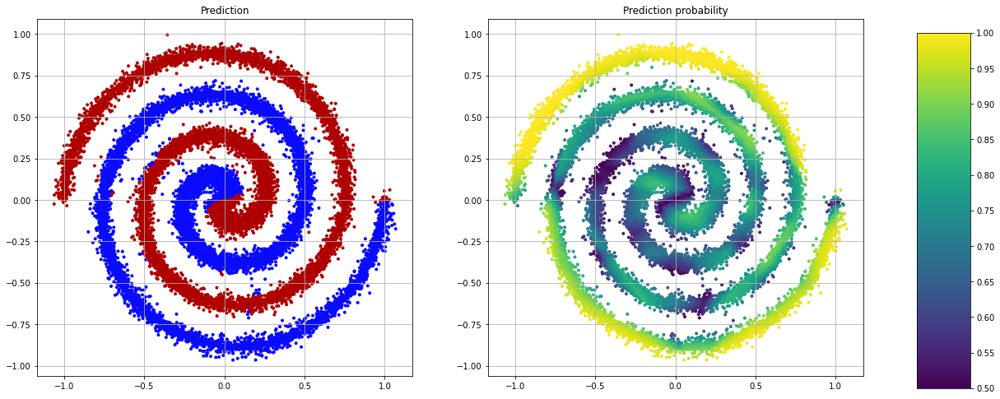

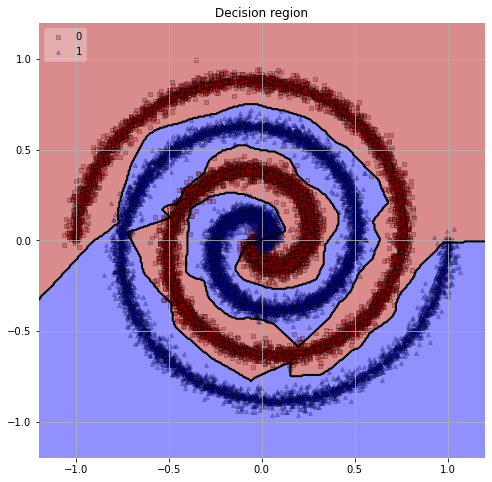

In [10]:
mlp_clf = MLPClassifier(batch_size=5000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.83      0.80      0.81     12562
           1       0.80      0.83      0.82     12438

    accuracy                           0.82     25000
   macro avg       0.82      0.82      0.82     25000
weighted avg       0.82      0.82      0.82     25000



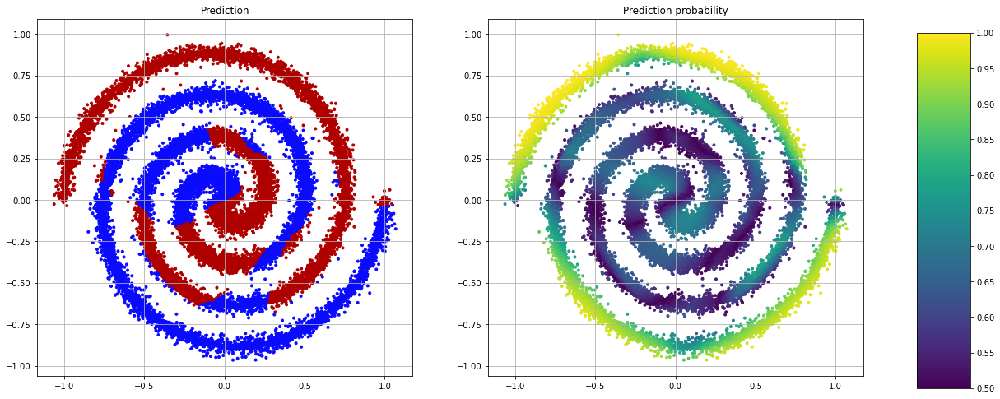

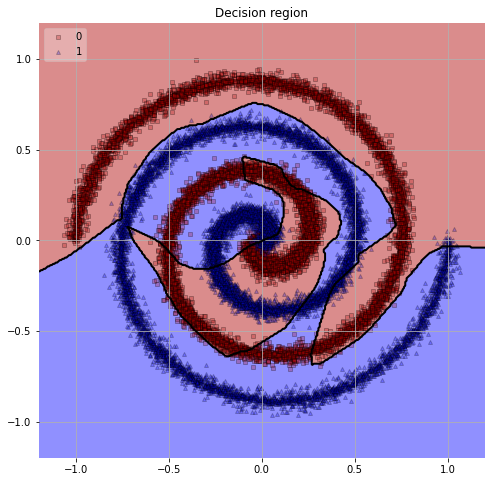

In [11]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
plot_prediction(X_test_augmented, y_test, mlp_clf)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.92      0.35      0.50     12562
           1       0.60      0.97      0.74     12438

    accuracy                           0.66     25000
   macro avg       0.76      0.66      0.62     25000
weighted avg       0.76      0.66      0.62     25000



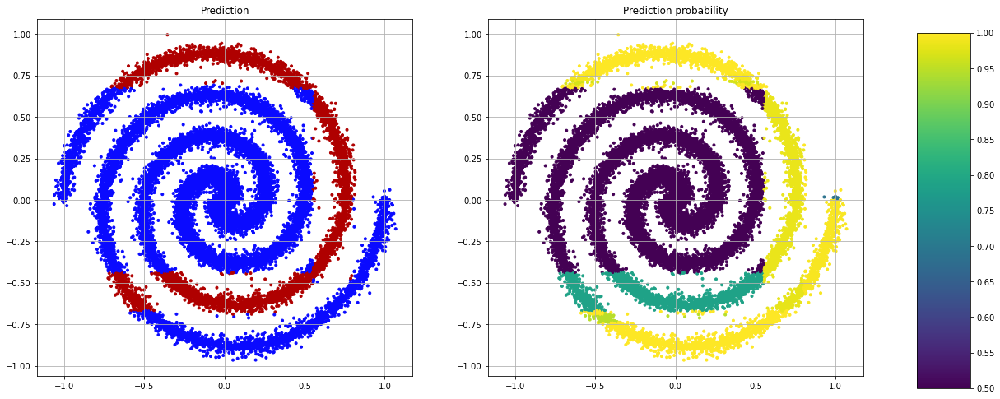

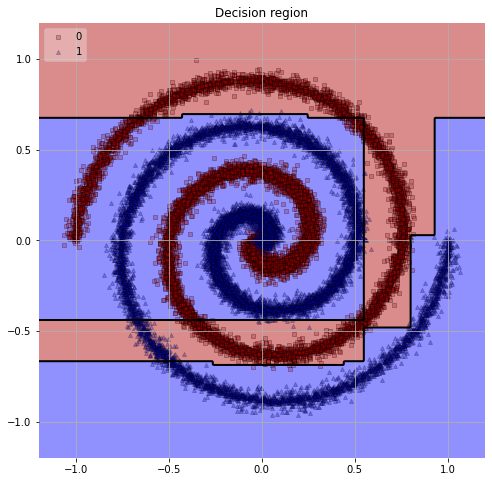

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.87      0.90      0.88     12562
           1       0.90      0.86      0.88     12438

    accuracy                           0.88     25000
   macro avg       0.88      0.88      0.88     25000
weighted avg       0.88      0.88      0.88     25000



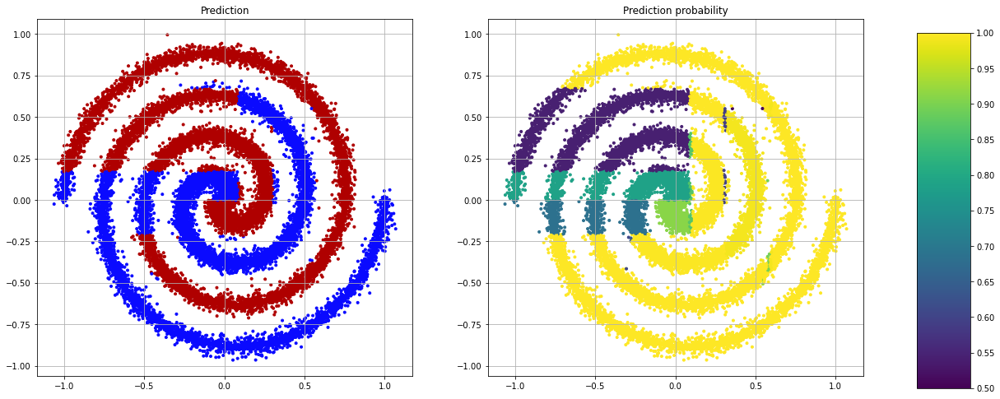

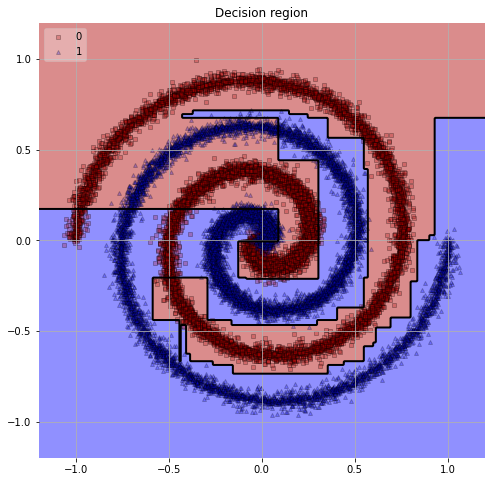

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12562
           1       0.99      0.99      0.99     12438

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



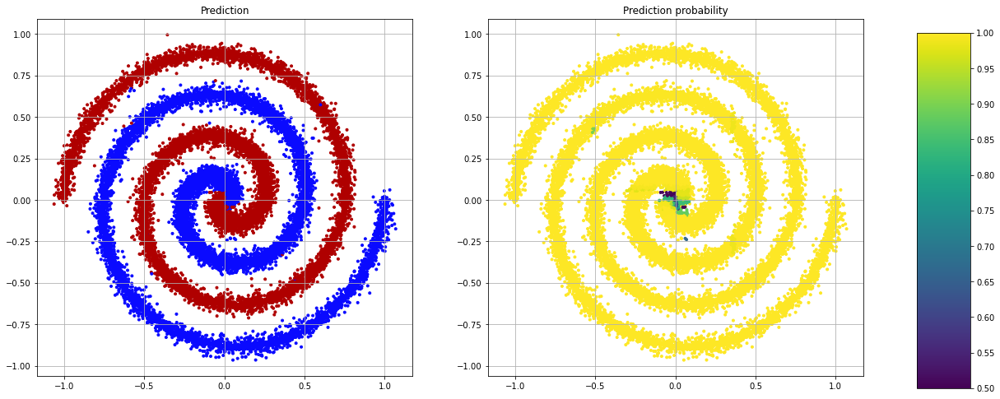

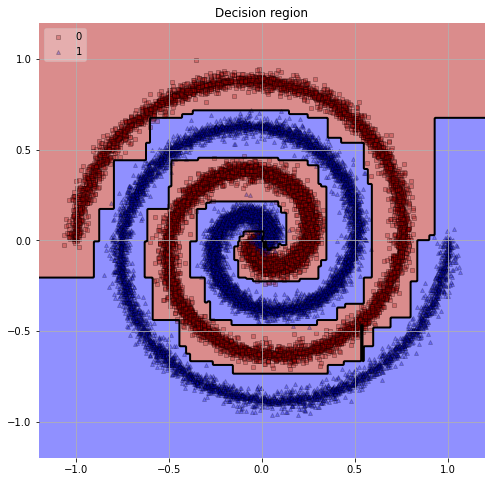

In [12]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    plot_prediction(X_test_augmented, y_test, dt_clf)

# Using $(x + y)/2$, $(x - y)/2$ as inputs

In [13]:
df2 = pd.DataFrame({"feat1": (df.x + df.y)/2, "feat2": (df.x - df.y)/2, "target": df.target})

In [14]:
X_train, X_test, y_train, y_test = train_test_split(
    df2[["feat1", "feat2"]], df2["target"],
    test_size=0.25, shuffle=True
)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.60      0.98      0.75     12450
           1       0.95      0.35      0.51     12550

    accuracy                           0.67     25000
   macro avg       0.78      0.67      0.63     25000
weighted avg       0.78      0.67      0.63     25000



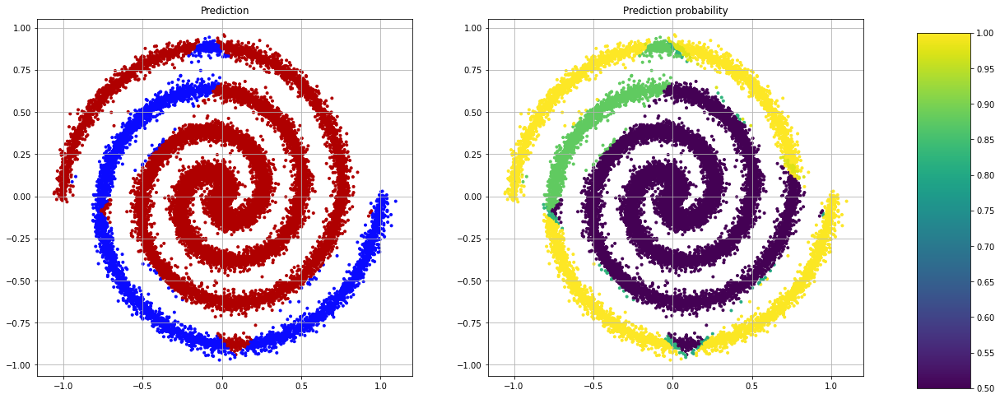

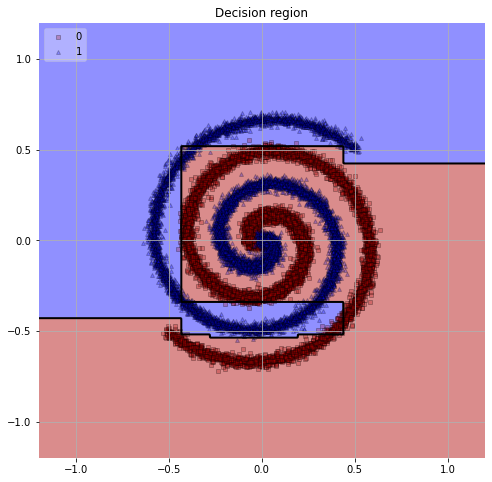

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.90      0.91      0.91     12450
           1       0.91      0.90      0.91     12550

    accuracy                           0.91     25000
   macro avg       0.91      0.91      0.91     25000
weighted avg       0.91      0.91      0.91     25000



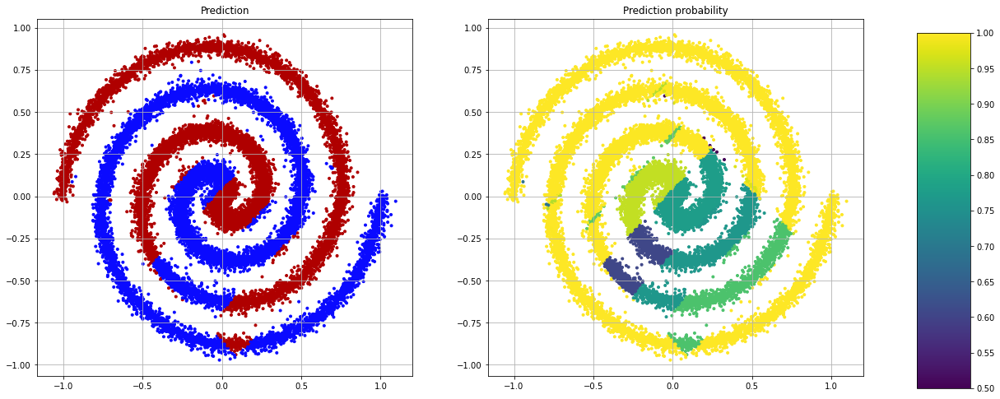

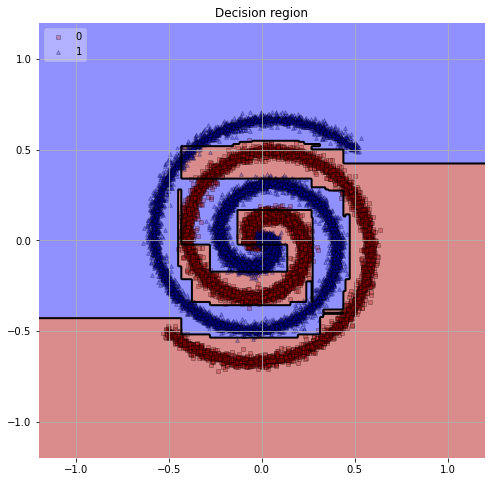

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12450
           1       0.99      0.99      0.99     12550

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



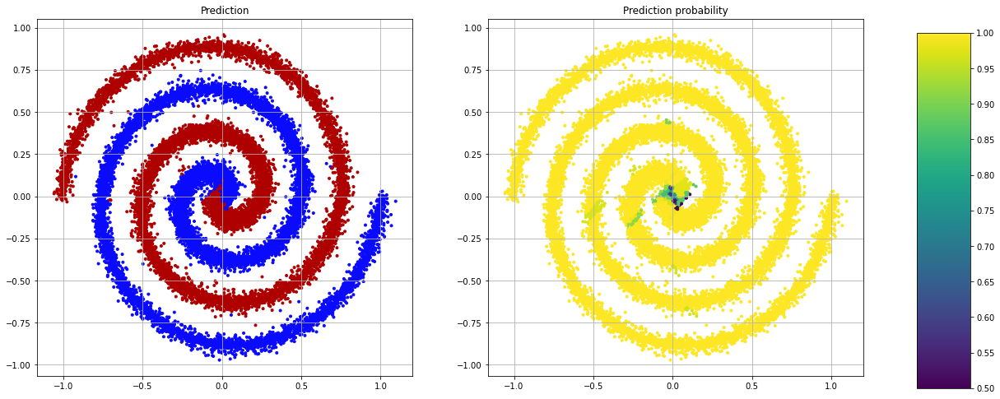

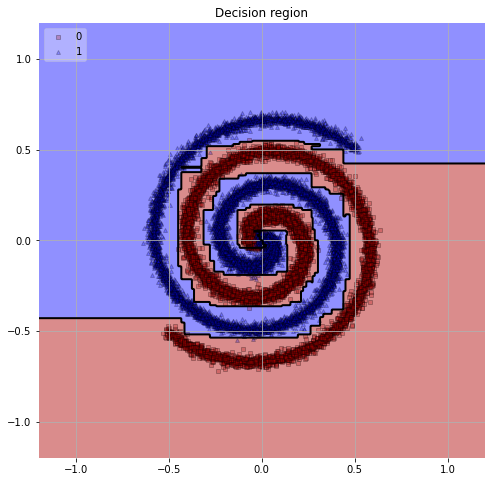

In [15]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, dt_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.48      0.44      0.46     12450
           1       0.49      0.53      0.51     12550

    accuracy                           0.48     25000
   macro avg       0.48      0.48      0.48     25000
weighted avg       0.48      0.48      0.48     25000



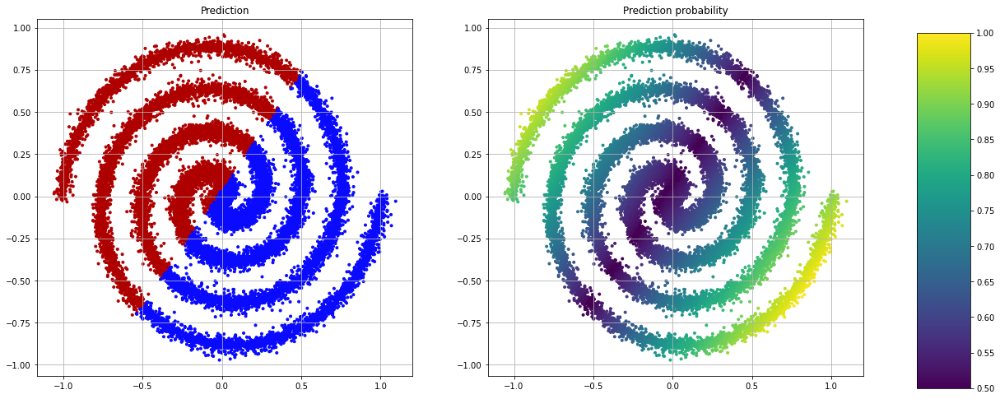

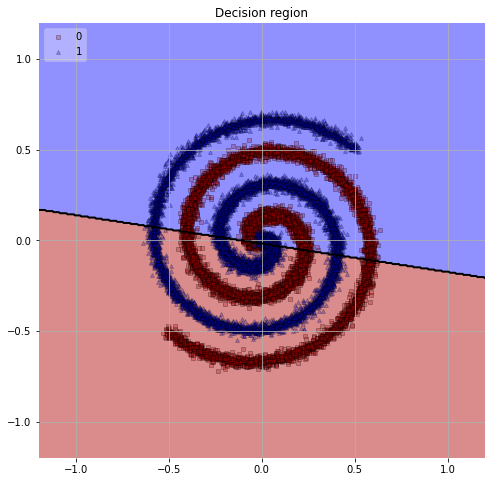

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.60      0.09      0.16     12450
           1       0.51      0.94      0.66     12550

    accuracy                           0.52     25000
   macro avg       0.55      0.51      0.41     25000
weighted avg       0.55      0.52      0.41     25000



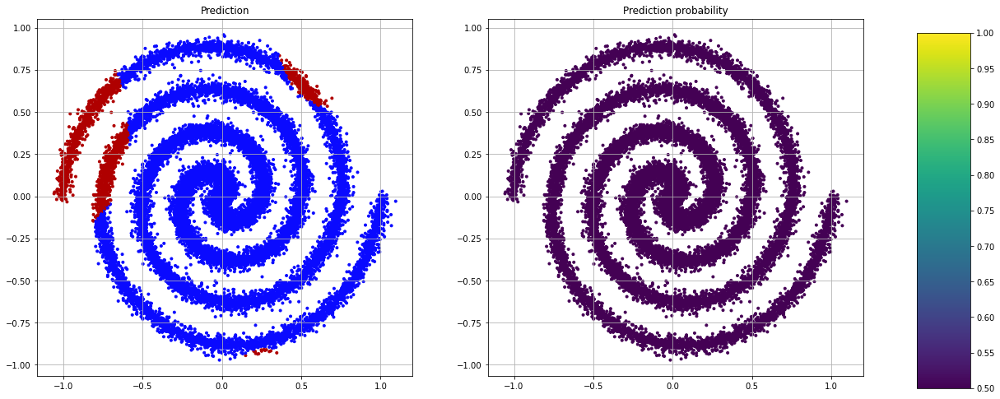

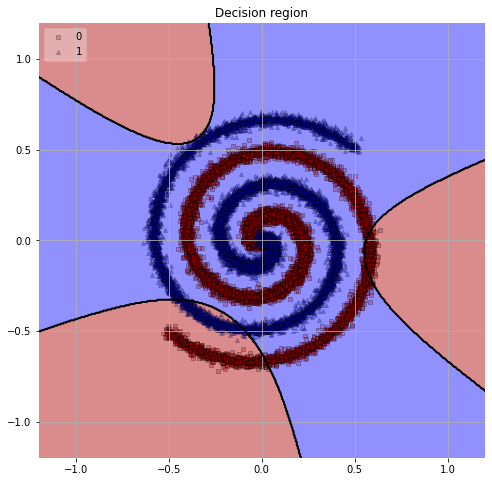

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.45      0.56      0.50     12450
           1       0.42      0.32      0.36     12550

    accuracy                           0.44     25000
   macro avg       0.43      0.44      0.43     25000
weighted avg       0.43      0.44      0.43     25000



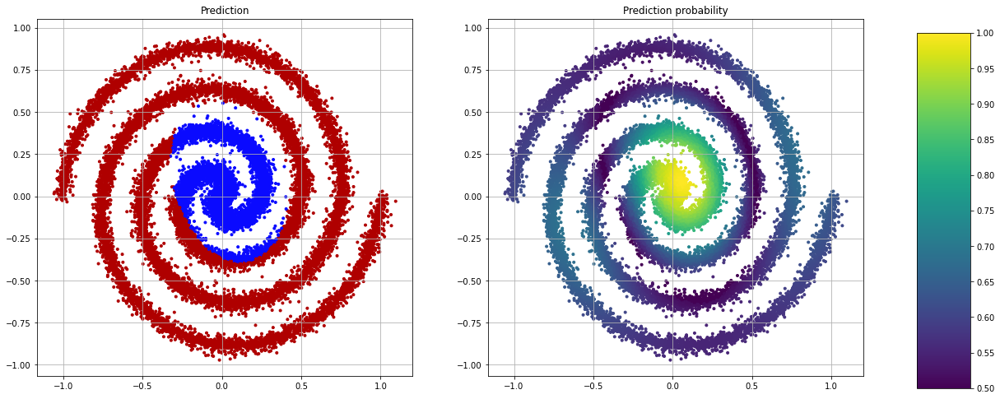

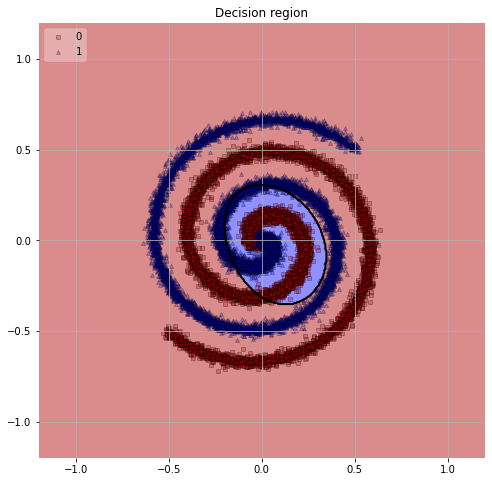

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.43      0.32      0.36     12450
           1       0.46      0.58      0.51     12550

    accuracy                           0.45     25000
   macro avg       0.44      0.45      0.44     25000
weighted avg       0.44      0.45      0.44     25000



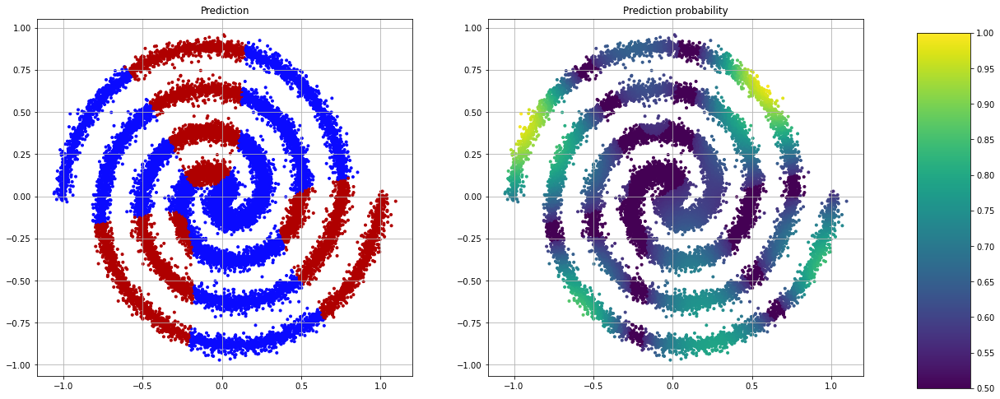

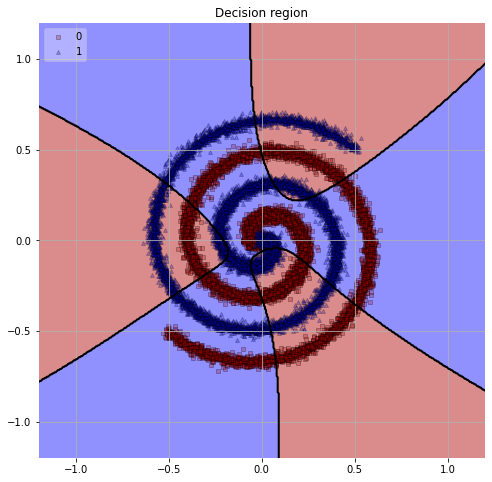

In [16]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, svc_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.66      0.71      0.68     12450
           1       0.69      0.64      0.67     12550

    accuracy                           0.68     25000
   macro avg       0.68      0.68      0.68     25000
weighted avg       0.68      0.68      0.68     25000



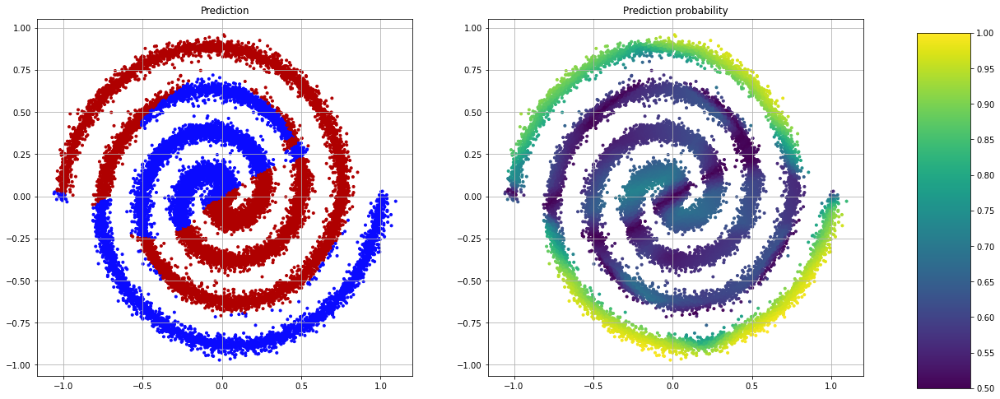

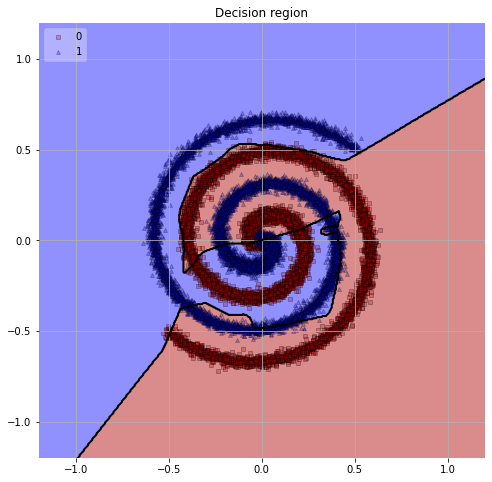

In [17]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.98      0.98      0.98     12450
           1       0.98      0.98      0.98     12550

    accuracy                           0.98     25000
   macro avg       0.98      0.98      0.98     25000
weighted avg       0.98      0.98      0.98     25000



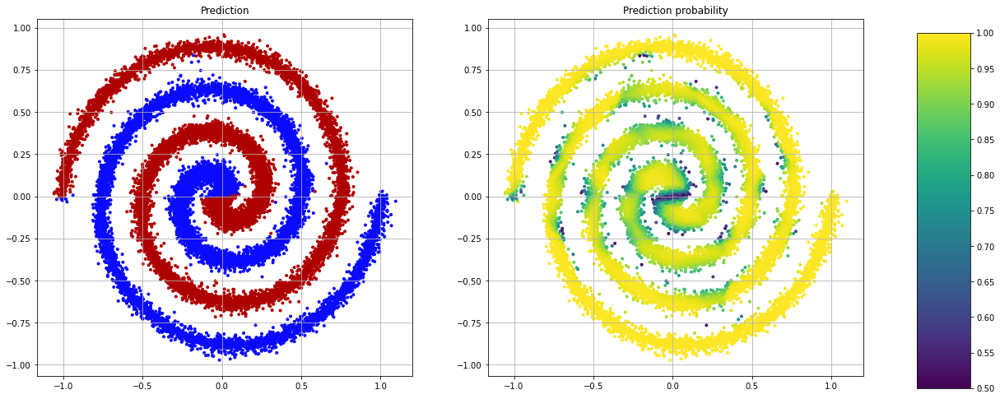

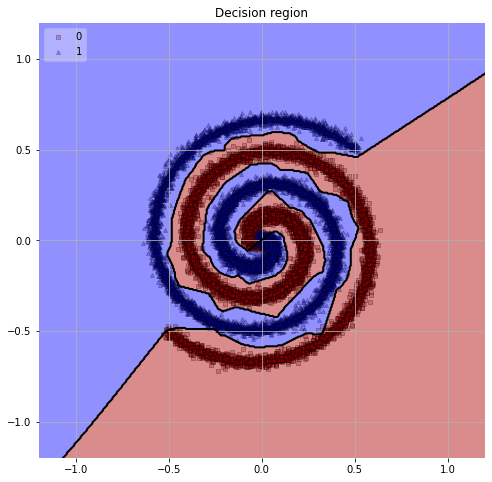

In [18]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12450
           1       0.99      0.99      0.99     12550

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



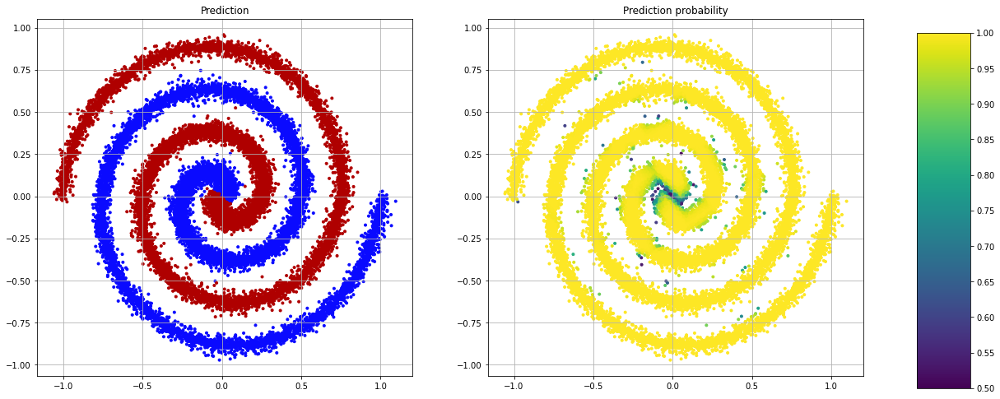

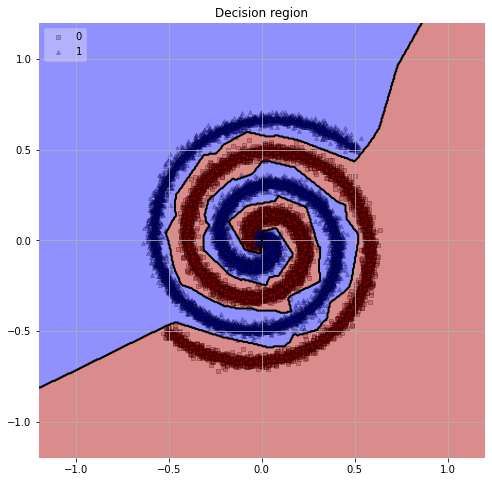

In [19]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300, hidden_layer_sizes=(32, 32))
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12450
           1       0.99      0.99      0.99     12550

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



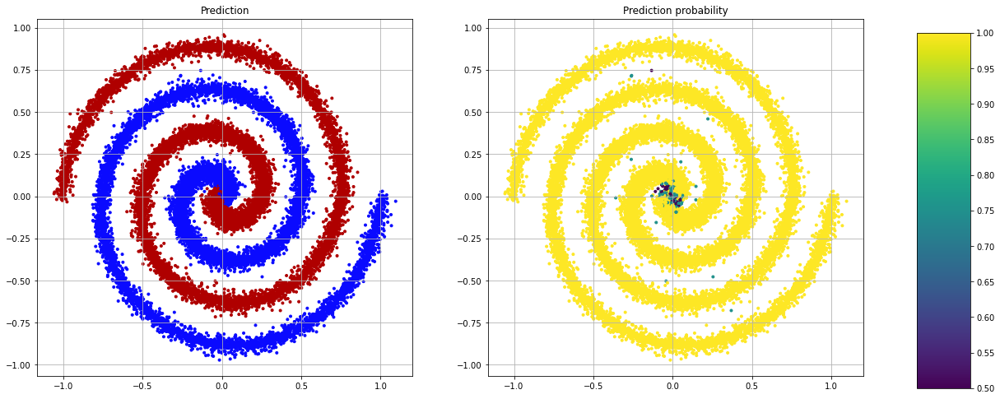

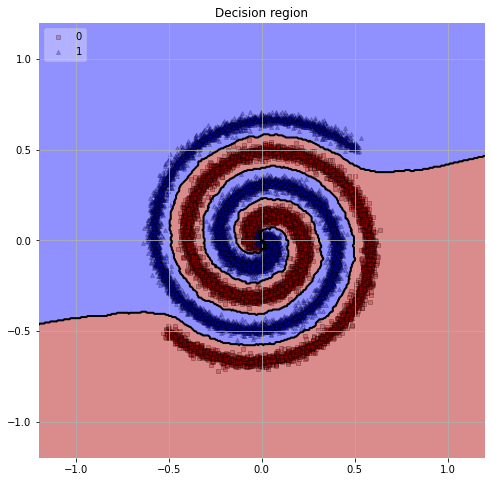

In [20]:
knn_clf = KNeighborsClassifier()
knn_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, knn_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, knn_clf)

# Using $sin(\pi x)$, $sin(\pi y)$ as inputs

In [21]:
df3 = pd.DataFrame({"feat1": np.sin(np.pi*df.x), "feat2": np.sin(np.pi*df.y), "target": df.target})

In [22]:
X_train, X_test, y_train, y_test = train_test_split(
    df3[["feat1", "feat2"]], df3["target"],
    test_size=0.25, shuffle=True
)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.82      0.64      0.72     12484
           1       0.70      0.86      0.77     12516

    accuracy                           0.75     25000
   macro avg       0.76      0.75      0.74     25000
weighted avg       0.76      0.75      0.74     25000



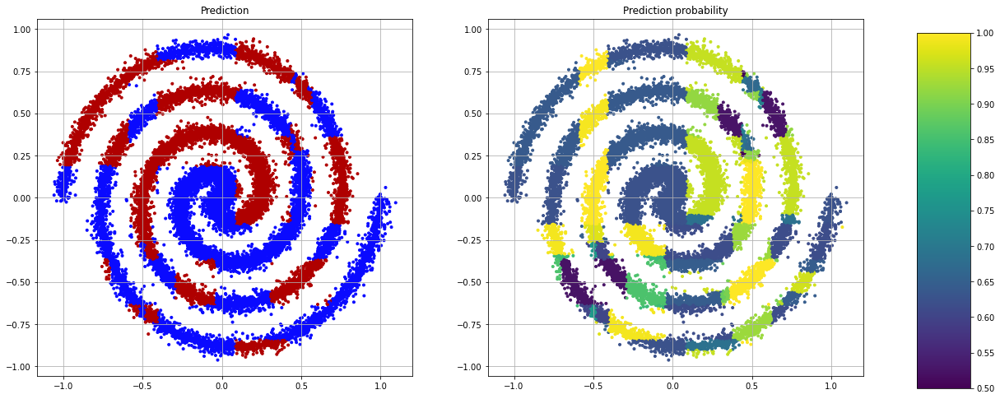

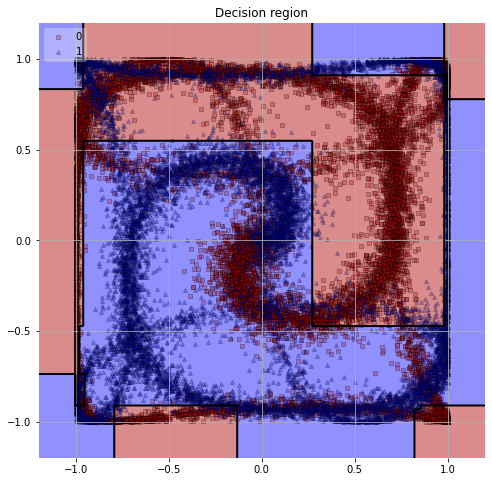

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.84      0.86      0.85     12484
           1       0.86      0.84      0.85     12516

    accuracy                           0.85     25000
   macro avg       0.85      0.85      0.85     25000
weighted avg       0.85      0.85      0.85     25000



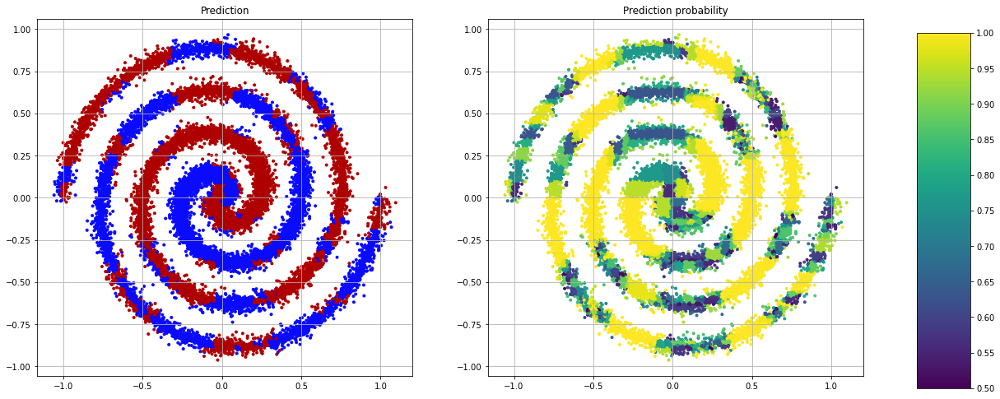

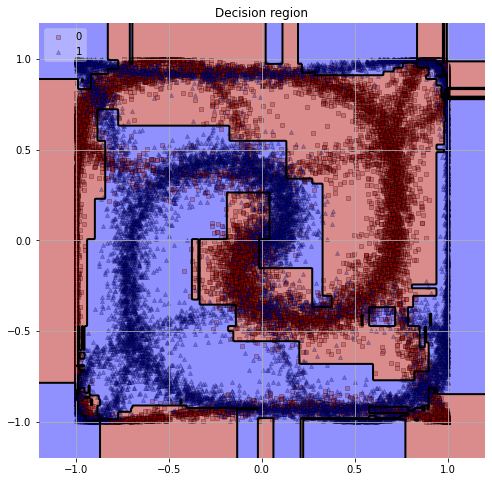

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       0.85      0.84      0.84     12484
           1       0.84      0.85      0.84     12516

    accuracy                           0.84     25000
   macro avg       0.84      0.84      0.84     25000
weighted avg       0.84      0.84      0.84     25000



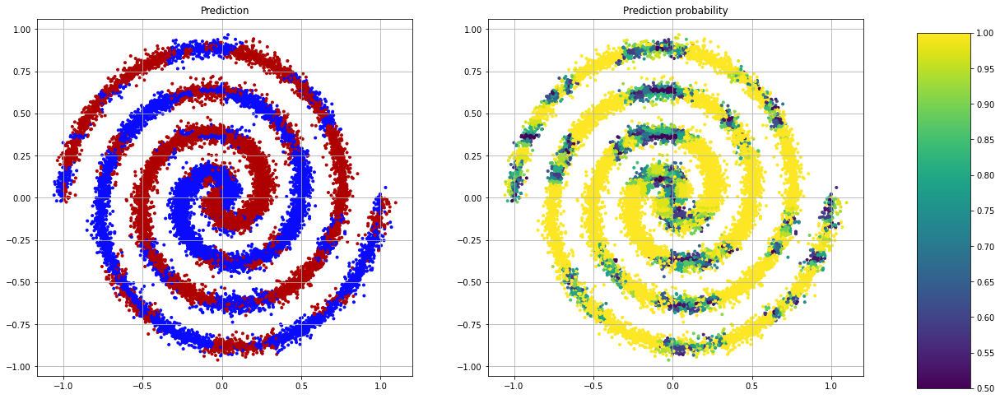

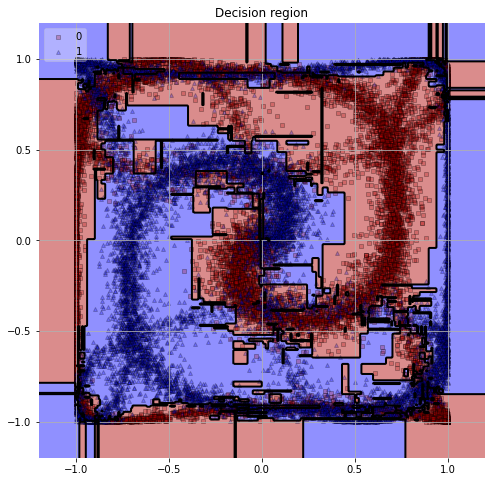

In [23]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, dt_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.54      0.52      0.53     12484
           1       0.54      0.55      0.54     12516

    accuracy                           0.54     25000
   macro avg       0.54      0.54      0.54     25000
weighted avg       0.54      0.54      0.54     25000



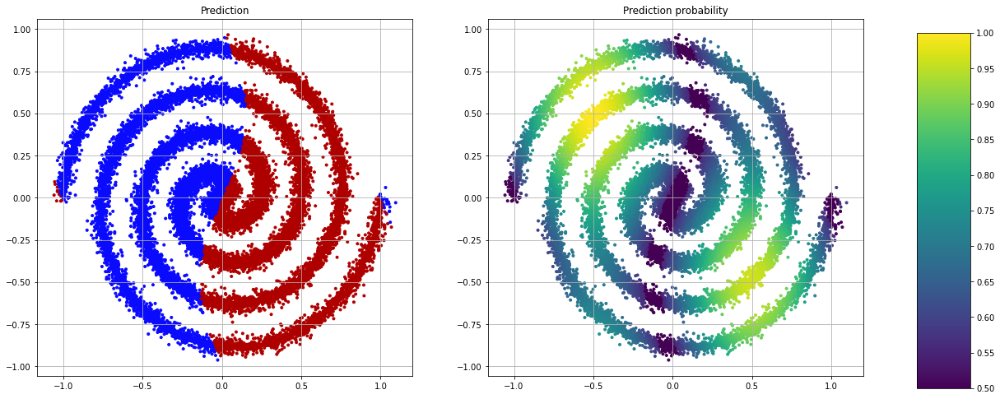

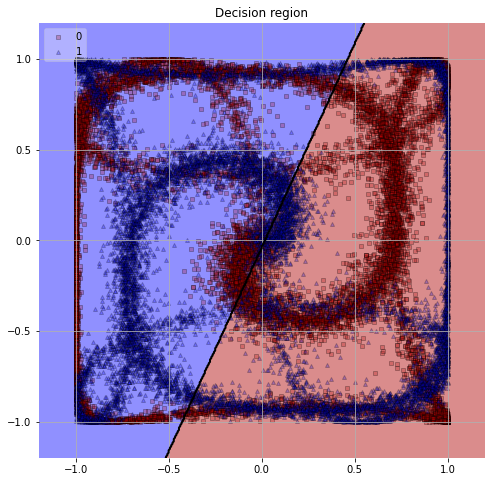

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.57      0.44      0.50     12484
           1       0.54      0.67      0.60     12516

    accuracy                           0.55     25000
   macro avg       0.56      0.55      0.55     25000
weighted avg       0.56      0.55      0.55     25000



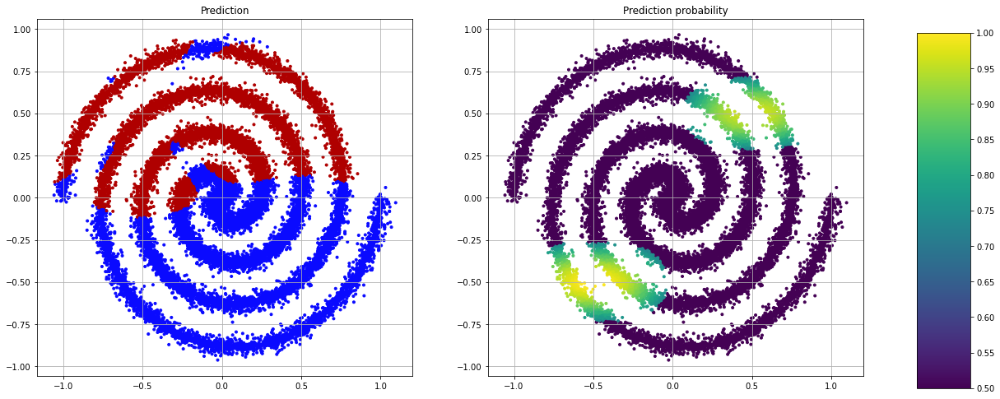

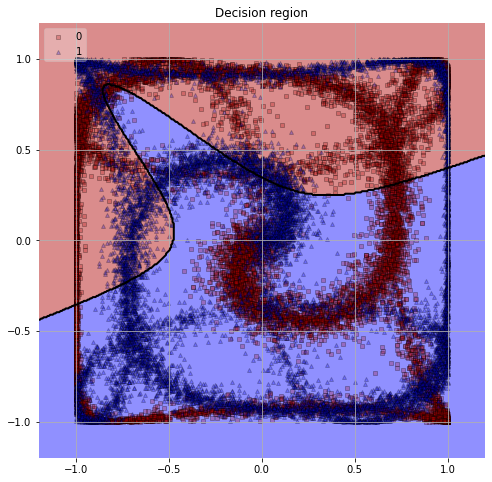

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.49      0.66      0.56     12484
           1       0.49      0.33      0.40     12516

    accuracy                           0.49     25000
   macro avg       0.49      0.49      0.48     25000
weighted avg       0.49      0.49      0.48     25000



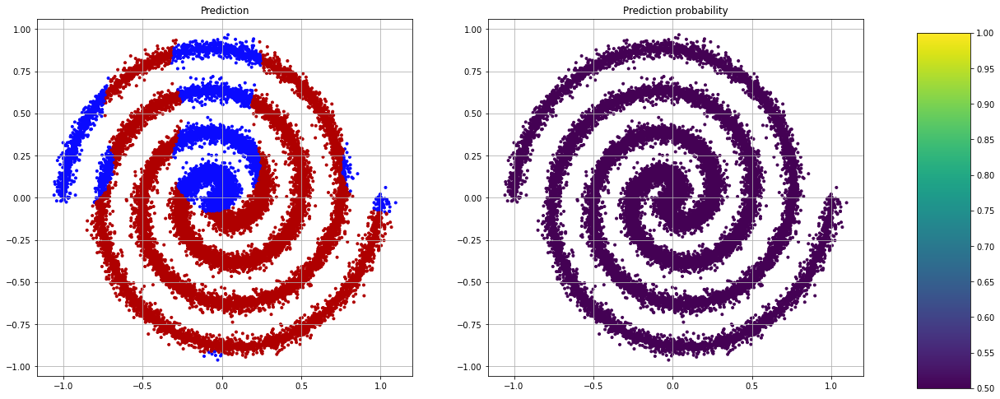

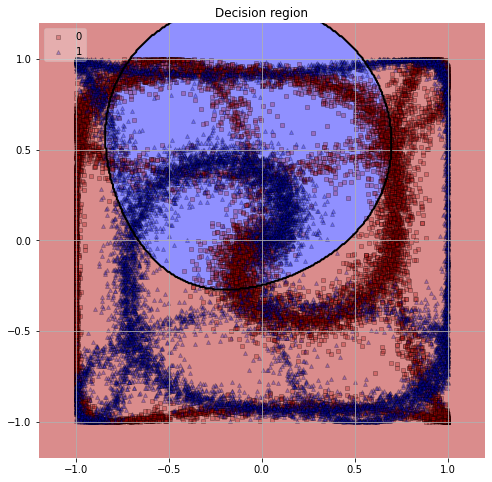

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.62      0.61      0.61     12484
           1       0.62      0.62      0.62     12516

    accuracy                           0.62     25000
   macro avg       0.62      0.62      0.62     25000
weighted avg       0.62      0.62      0.62     25000



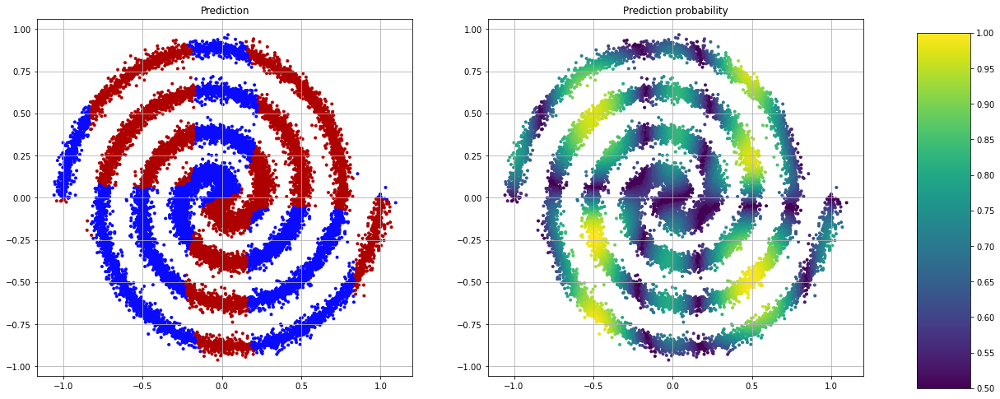

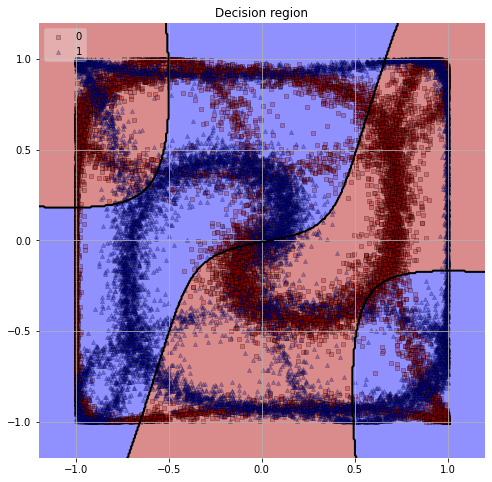

In [24]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, svc_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.78      0.76      0.77     12484
           1       0.77      0.79      0.78     12516

    accuracy                           0.78     25000
   macro avg       0.78      0.78      0.78     25000
weighted avg       0.78      0.78      0.78     25000



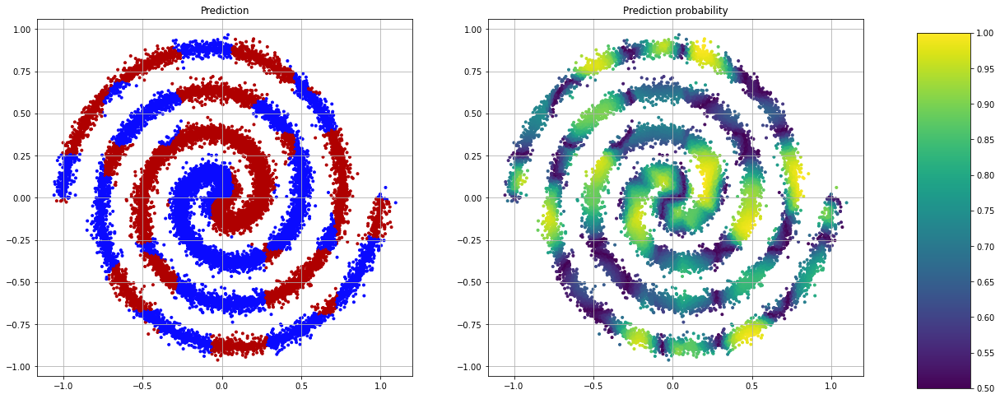

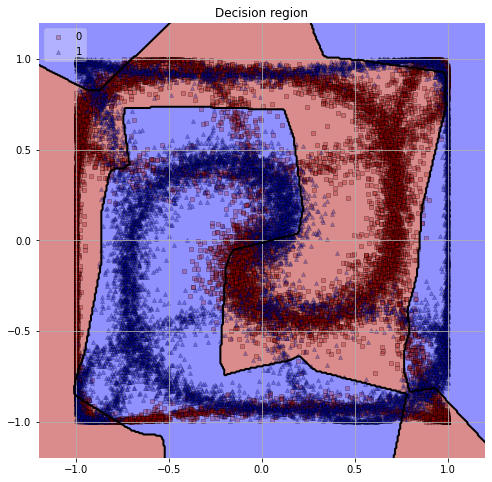

In [25]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.82      0.83      0.83     12484
           1       0.83      0.82      0.82     12516

    accuracy                           0.82     25000
   macro avg       0.82      0.82      0.82     25000
weighted avg       0.82      0.82      0.82     25000



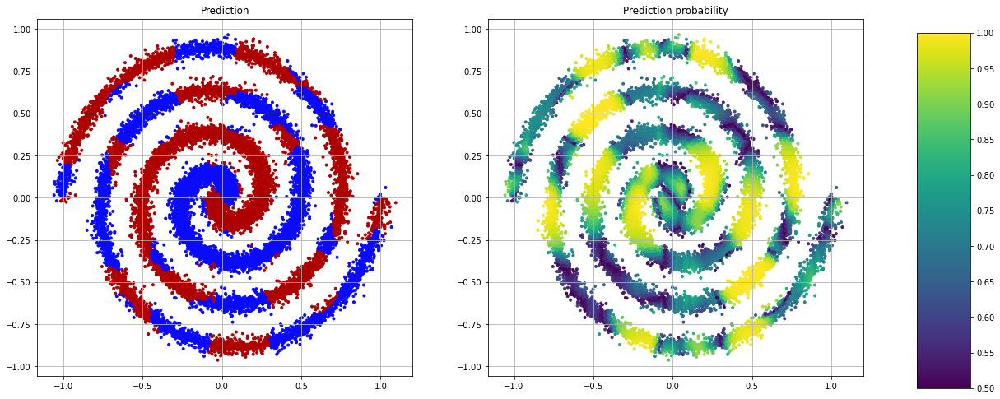

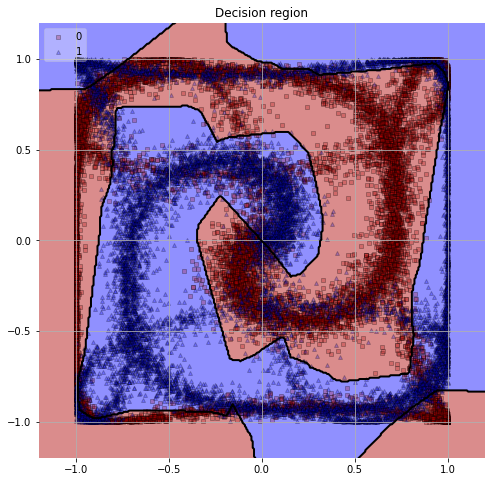

In [26]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

              precision    recall  f1-score   support

           0       0.81      0.87      0.84     12484
           1       0.86      0.80      0.83     12516

    accuracy                           0.84     25000
   macro avg       0.84      0.84      0.84     25000
weighted avg       0.84      0.84      0.84     25000



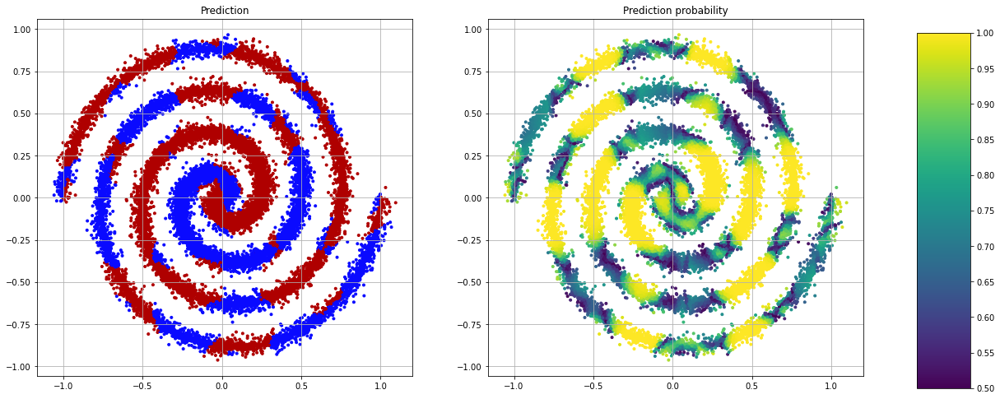

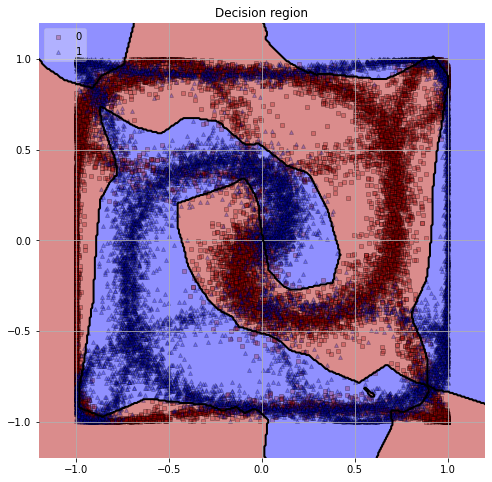

In [27]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300, hidden_layer_sizes=(32, 32))
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

# Using $sin(\pi (x + y)/2)$, $sin(\pi (x - y)/2)$ as inputs

In [28]:
df4 = pd.DataFrame({
    "feat1": np.sin(np.pi*(df.x + df.y)/2),
    "feat2": np.sin(np.pi*(df.x - df.y)/2),
    "target": df.target
})

In [29]:
X_train, X_test, y_train, y_test = train_test_split(
    df4[["feat1", "feat2"]], df4["target"],
    test_size=0.25, shuffle=True
)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.87      0.41      0.56     12618
           1       0.61      0.94      0.74     12382

    accuracy                           0.67     25000
   macro avg       0.74      0.67      0.65     25000
weighted avg       0.74      0.67      0.65     25000



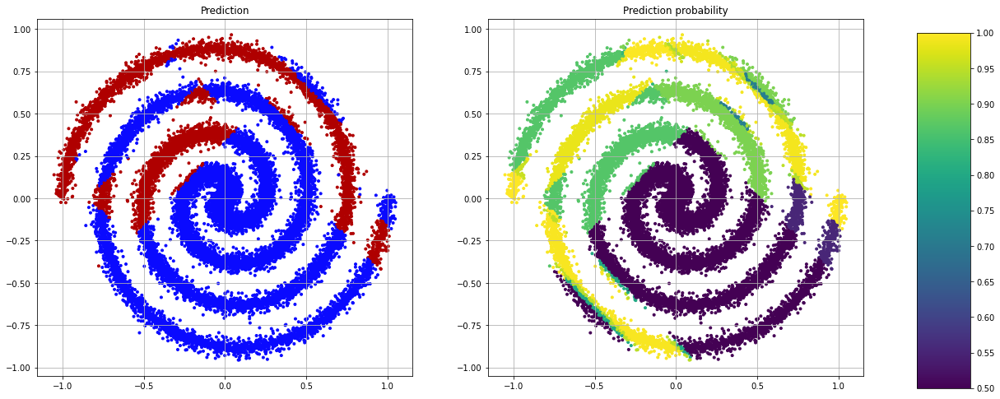

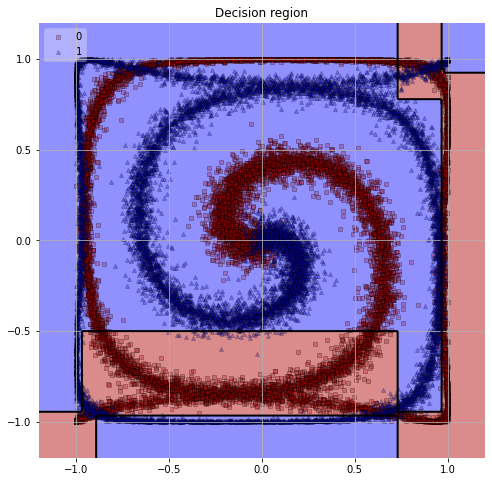

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.95      0.92      0.94     12618
           1       0.92      0.95      0.94     12382

    accuracy                           0.94     25000
   macro avg       0.94      0.94      0.94     25000
weighted avg       0.94      0.94      0.94     25000



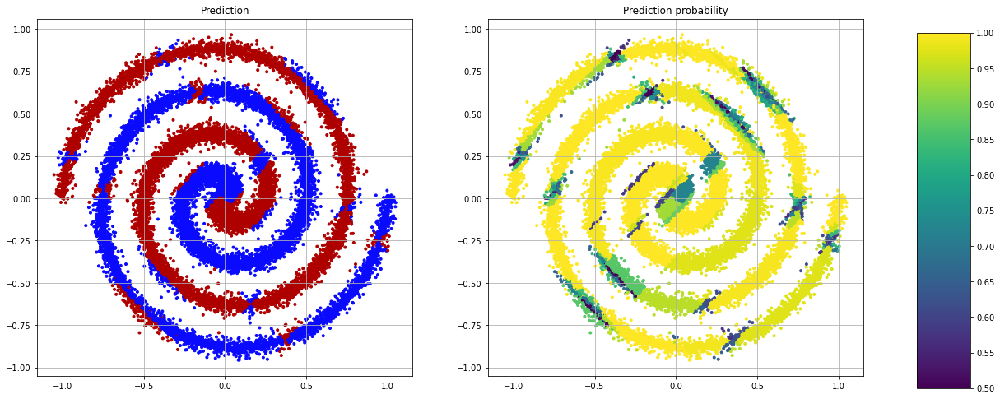

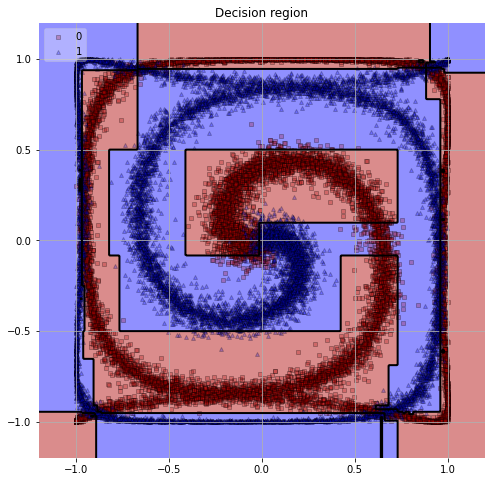

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       0.95      0.95      0.95     12618
           1       0.95      0.95      0.95     12382

    accuracy                           0.95     25000
   macro avg       0.95      0.95      0.95     25000
weighted avg       0.95      0.95      0.95     25000



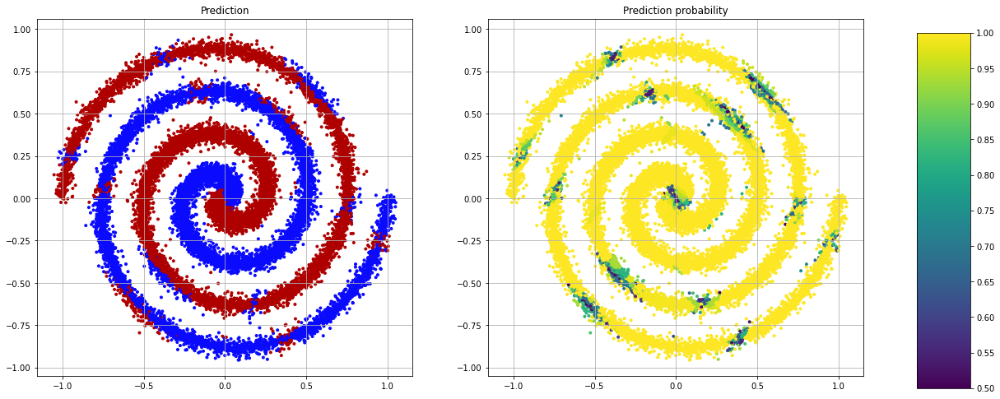

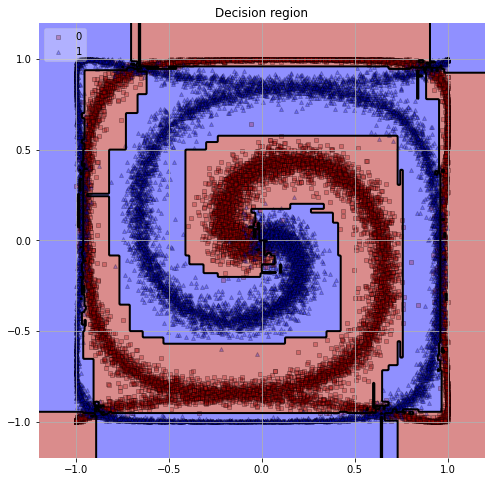

In [30]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, dt_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.52      0.50      0.51     12618
           1       0.51      0.53      0.52     12382

    accuracy                           0.51     25000
   macro avg       0.51      0.51      0.51     25000
weighted avg       0.51      0.51      0.51     25000



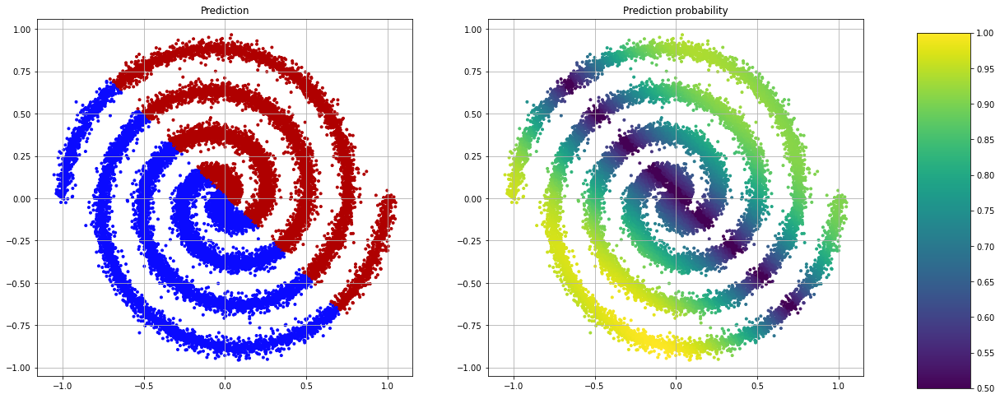

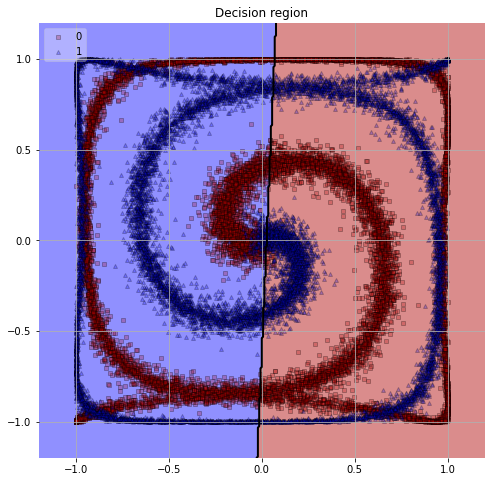

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.56      0.37      0.45     12618
           1       0.52      0.70      0.60     12382

    accuracy                           0.54     25000
   macro avg       0.54      0.54      0.52     25000
weighted avg       0.54      0.54      0.52     25000



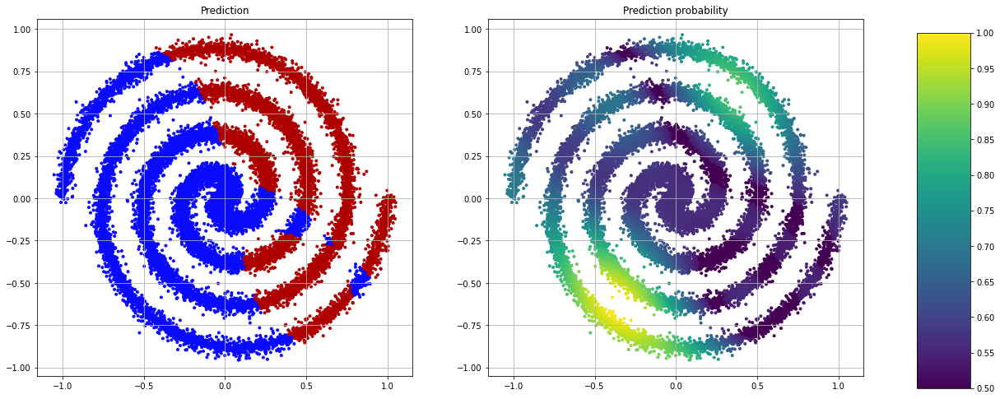

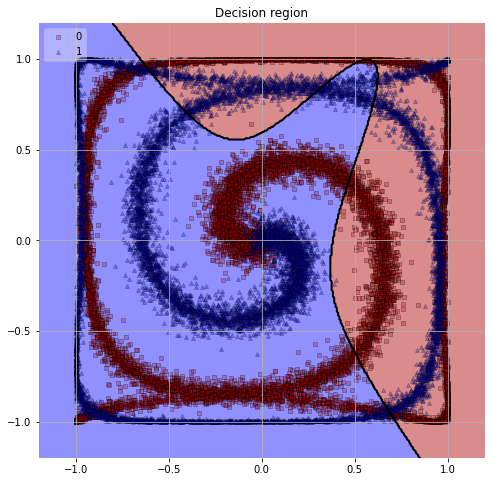

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.44      0.53      0.48     12618
           1       0.38      0.30      0.33     12382

    accuracy                           0.42     25000
   macro avg       0.41      0.41      0.41     25000
weighted avg       0.41      0.42      0.41     25000



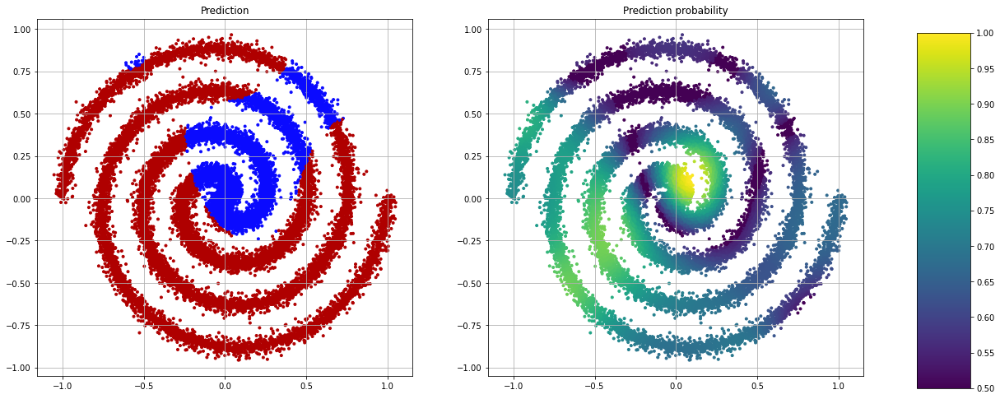

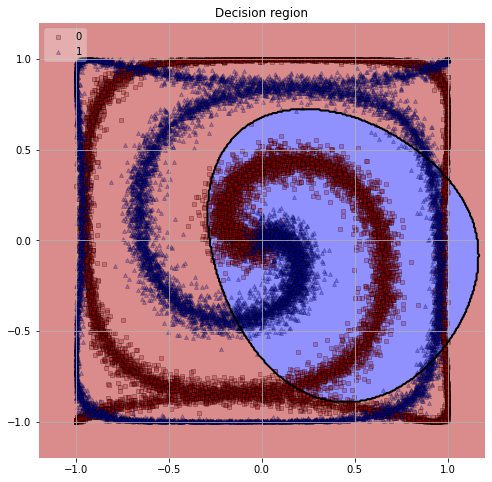

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.50      0.47      0.48     12618
           1       0.49      0.52      0.50     12382

    accuracy                           0.49     25000
   macro avg       0.49      0.49      0.49     25000
weighted avg       0.49      0.49      0.49     25000



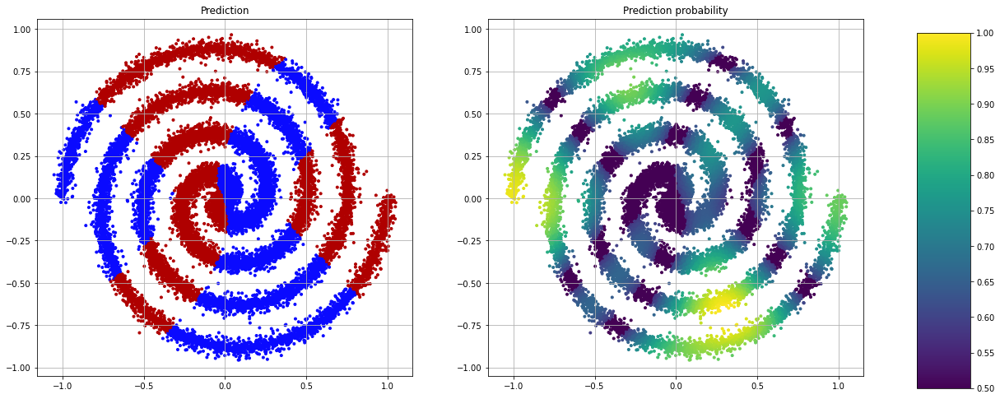

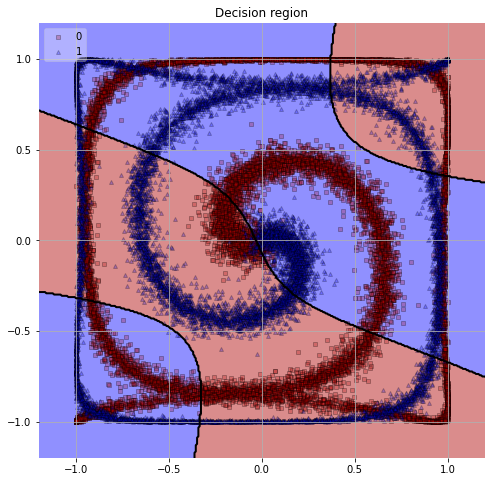

In [31]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, svc_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.89      0.91      0.90     12618
           1       0.91      0.89      0.90     12382

    accuracy                           0.90     25000
   macro avg       0.90      0.90      0.90     25000
weighted avg       0.90      0.90      0.90     25000



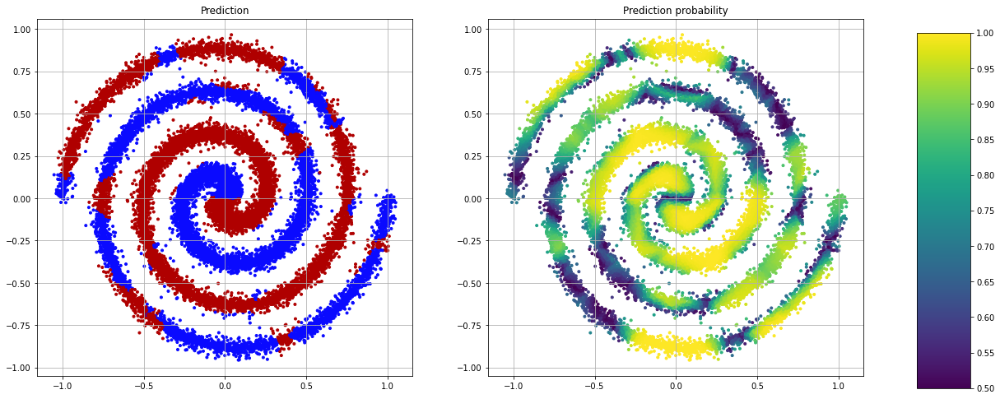

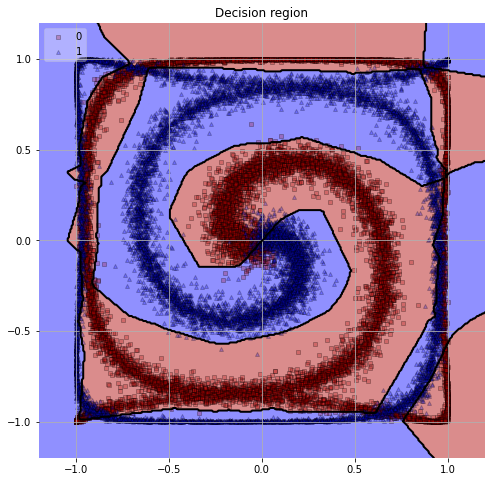

In [32]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.95      0.96      0.95     12618
           1       0.96      0.94      0.95     12382

    accuracy                           0.95     25000
   macro avg       0.95      0.95      0.95     25000
weighted avg       0.95      0.95      0.95     25000



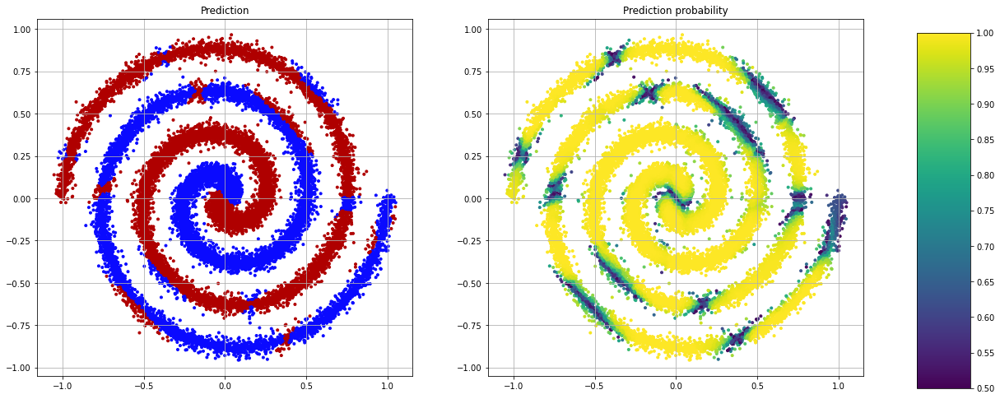

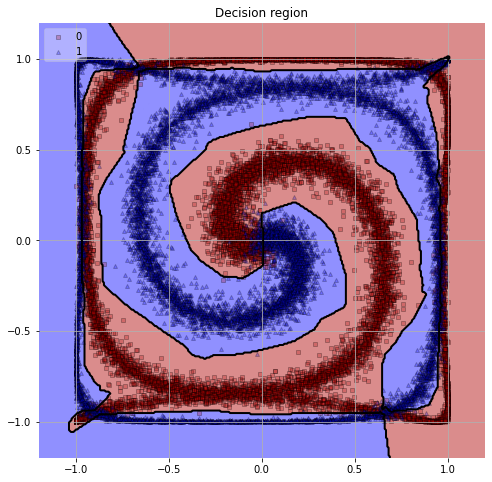

In [33]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300, hidden_layer_sizes=(32, 32))
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

              precision    recall  f1-score   support

           0       0.96      0.96      0.96     12618
           1       0.96      0.96      0.96     12382

    accuracy                           0.96     25000
   macro avg       0.96      0.96      0.96     25000
weighted avg       0.96      0.96      0.96     25000



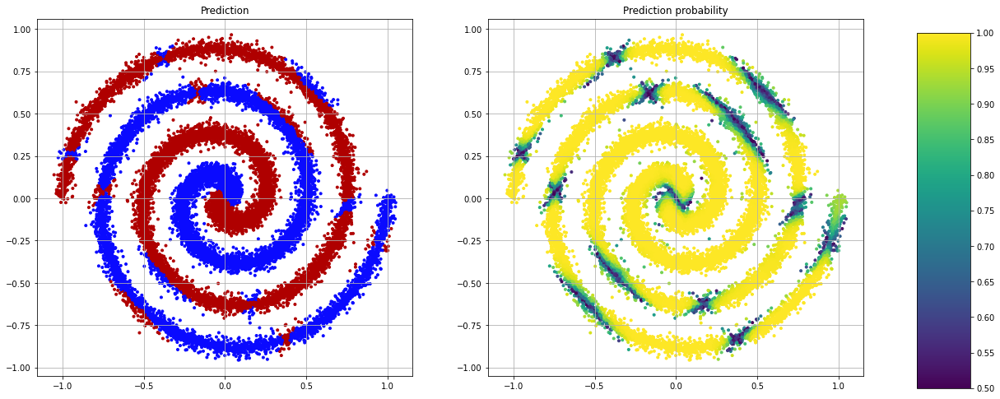

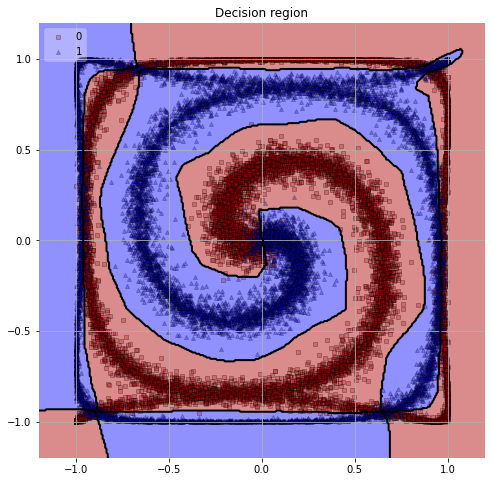

In [34]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300, hidden_layer_sizes=(64, 64))
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.80      0.80      0.80     12618
           1       0.80      0.80      0.80     12382

    accuracy                           0.80     25000
   macro avg       0.80      0.80      0.80     25000
weighted avg       0.80      0.80      0.80     25000



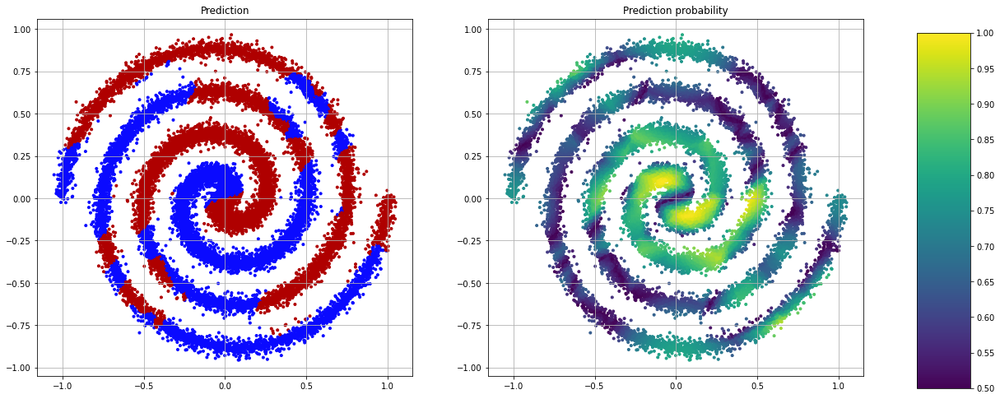

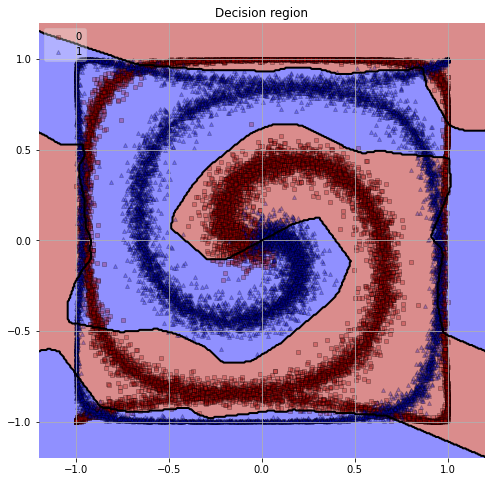

In [35]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

              precision    recall  f1-score   support

           0       0.96      0.95      0.95     12618
           1       0.95      0.95      0.95     12382

    accuracy                           0.95     25000
   macro avg       0.95      0.95      0.95     25000
weighted avg       0.95      0.95      0.95     25000



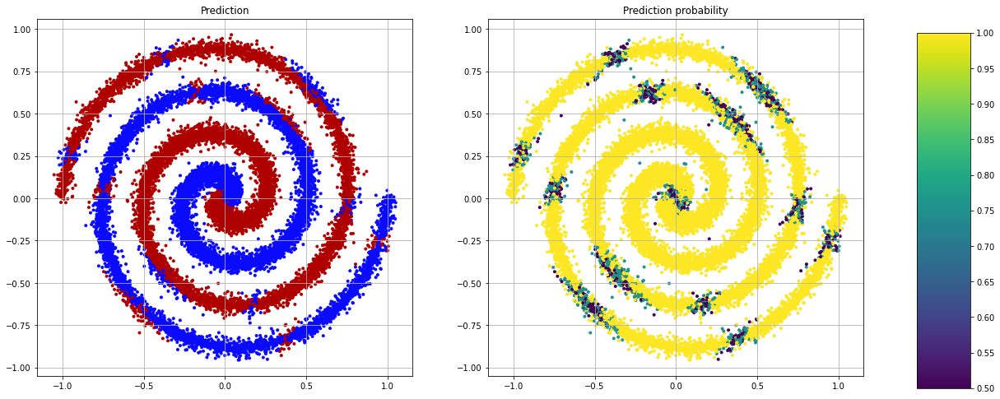

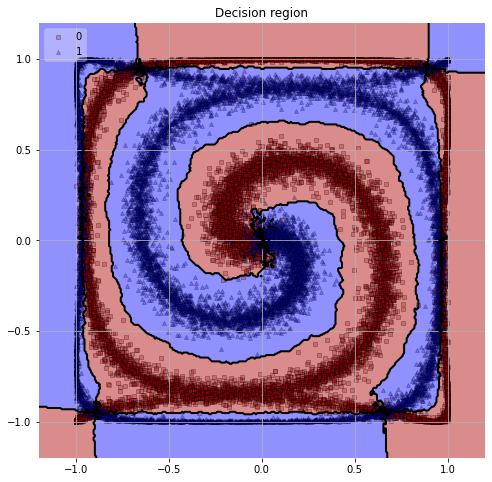

In [36]:
knn_clf = KNeighborsClassifier()
knn_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, knn_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, knn_clf)